In [1]:
from bs4 import BeautifulSoup
import requests
import time, os

In [2]:
from selenium import webdriver
from selenium.webdriver.common.keys import Keys

chromedriver = "/home/aziker/WebDriver/chromedriver"
os.environ["webdriver.chrome.driver"] = chromedriver

In [3]:
driver = webdriver.Chrome(chromedriver)

In [4]:
#player name and transfer values
driver.get('https://www.transfermarkt.us/spieler-statistik/wertvollstespieler/marktwertetop')

In [5]:
open_dropdown = driver.find_element_by_xpath('//div[contains(@class, "inline-select")]')
open_dropdown.click()

In [6]:
search_box = driver.find_element_by_xpath("//input[@type='search']")
search_box.send_keys("for")
search_box.send_keys(Keys.RETURN) 

In [7]:
refresh_page = driver.find_element_by_xpath('//input[contains(@class, "right small button")]')
refresh_page.click()

In [8]:
soup = BeautifulSoup(driver.page_source, 'html.parser')

In [9]:
#testing it finds first name in table
print(soup.find('td', class_="hauptlink").text)

Kylian Mbappé


In [10]:
#testing it finds correct transfer value for first name in table
print(soup.find('td', class_="rechts hauptlink").text)

$176.00m 


In [11]:
#testing first page as a single dictionary
first_page_names = [name.text for name in soup.find_all('a', class_="spielprofil_tooltip tooltipstered")][:25]
first_page_values = [tf.text.replace('\xa0','') for tf in soup.find_all('td', class_="rechts hauptlink")]

first_page_nv = {}
for k,v in zip(first_page_names, first_page_values):
    first_page_nv[k] = v
first_page_nv

{'Kylian Mbappé': '$176.00m',
 'Erling Haaland': '$143.00m',
 'Harry Kane': '$132.00m',
 'Jadon Sancho': '$110.00m',
 'Mohamed Salah': '$110.00m',
 'Romelu Lukaku': '$110.00m',
 'Neymar': '$110.00m',
 'Raheem Sterling': '$99.00m',
 'Marcus Rashford': '$93.50m',
 'Sadio Mané': '$93.50m',
 'Heung-min Son': '$93.50m',
 'João Félix': '$88.00m',
 'Lautaro Martínez': '$88.00m',
 'Lionel Messi': '$88.00m',
 'Mikel Oyarzabal': '$77.00m',
 'Federico Chiesa': '$77.00m',
 'Serge Gnabry': '$77.00m',
 'Kingsley Coman': '$71.50m',
 'Jack Grealish': '$71.50m',
 'Timo Werner': '$71.50m',
 'Ansu Fati': '$66.00m',
 'Gabriel Jesus': '$66.00m',
 'Leroy Sané': '$66.00m',
 'Antoine Griezmann': '$66.00m',
 'Robert Lewandowski': '$66.00m'}

In [12]:
#going to next page test, doesn't need to run in final
#var=2
#next_table = driver.find_element_by_xpath(f'//li[contains(@title, "Page {var}")]')

#next_table.click()


In [13]:
#put it all together

s_names = [name.text for name in soup.find('table', class_="items").find_all('a', class_="spielprofil_tooltip")]
s_values = [float(tf.text.replace('m\xa0','').replace('$', '').replace('.%0', '')) for tf \
                   in soup.find_all('td', class_="rechts hauptlink")]

for i in range(2,21):
    next_table = driver.find_element_by_xpath(f'//li[contains(@title, "Page {i}")]')
    next_table.click()
    
    time.sleep(3)
    
    soup2 = BeautifulSoup(driver.page_source, 'html.parser')
    
    s_names.extend([name.text for name in soup2.find('table', class_="items").\
                  find_all('a', class_="spielprofil_tooltip")])
    
    s_values.extend([float(tf.text.replace('m\xa0','').replace('$', '').replace('.%0', '')) for tf \
                   in soup2.find_all('td', class_="rechts hauptlink")])
    
    time.sleep(4)
    
   


In [13]:
striker_dict = {} 

for k,v in zip(s_names, s_values):
    striker_dict[k] = v

striker_dict

{'Kylian Mbappé': 176.0,
 'Erling Haaland': 143.0,
 'Harry Kane': 132.0,
 'Jadon Sancho': 110.0,
 'Mohamed Salah': 110.0,
 'Romelu Lukaku': 110.0,
 'Neymar': 110.0,
 'Raheem Sterling': 99.0,
 'Marcus Rashford': 93.5,
 'Sadio Mané': 93.5,
 'Heung-min Son': 93.5,
 'João Félix': 88.0,
 'Lautaro Martínez': 88.0,
 'Lionel Messi': 88.0,
 'Mikel Oyarzabal': 77.0,
 'Federico Chiesa': 77.0,
 'Serge Gnabry': 77.0,
 'Kingsley Coman': 71.5,
 'Jack Grealish': 71.5,
 'Timo Werner': 71.5,
 'Ansu Fati': 66.0,
 'Gabriel Jesus': 66.0,
 'Leroy Sané': 66.0,
 'Antoine Griezmann': 66.0,
 'Robert Lewandowski': 66.0,
 'Richarlison': 60.5,
 'Mason Greenwood': 55.0,
 'Victor Osimhen': 55.0,
 'Ferran Torres': 55.0,
 'Christian Pulisic': 55.0,
 'Ousmane Dembélé': 55.0,
 'Paulo Dybala': 55.0,
 'Roberto Firmino': 55.0,
 'Lorenzo Insigne': 52.8,
 'Diogo Jota': 49.5,
 'Hirving Lozano': 49.5,
 'Dominic Calvert-Lewin': 49.5,
 'André Silva': 49.5,
 'Anthony Martial': 49.5,
 'Memphis Depay': 49.5,
 'Wilfried Zaha': 49.5,

In [14]:
import pandas as pd
striker_dict = {'Name': s_names, 'Market Value (in millions USD)': s_values}
striker_data = pd.DataFrame.from_dict(striker_dict)
striker_data.head()

,Name,Market Value (in millions USD)
0,Kylian Mbappé,176.0
1,Erling Haaland,143.0
2,Harry Kane,132.0
3,Jadon Sancho,110.0
4,Mohamed Salah,110.0


In [15]:
striker_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500 entries, 0 to 499
Data columns (total 2 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Name                            500 non-null    object 
 1   Market Value (in millions USD)  500 non-null    float64
dtypes: float64(1), object(1)
memory usage: 7.9+ KB


In [59]:
#saving local copy
striker_data.to_csv('striker_data.csv')

In [8]:
#loading local copy
test_str=pd.read_csv('striker_data.csv', index_col='Unnamed: 0')
test_str

,Name,Market Value (in millions USD)
0,Kylian Mbappé,176.0
1,Erling Haaland,143.0
2,Harry Kane,132.0
3,Jadon Sancho,110.0
4,Mohamed Salah,110.0
...,...,...
495,José Luis Morales,6.6
496,Shon Weissman,6.6
497,Nemanja Radonjic,6.6
498,Baghdad Bounedjah,6.6


In [16]:
#player name and transfer values
driver.get('https://www.transfermarkt.us/spieler-statistik/wertvollstespieler/marktwertetop')

In [17]:
#getting midfield data
open_dropdown = driver.find_element_by_xpath('//div[contains(@class, "inline-select")]')
open_dropdown.click()

In [18]:
search_box = driver.find_element_by_xpath("//input[@type='search']")
search_box.send_keys("mid")
search_box.send_keys(Keys.RETURN) 

In [19]:
refresh_page = driver.find_element_by_xpath('//input[contains(@class, "right small button")]')
refresh_page.click()

In [20]:
soup = BeautifulSoup(driver.page_source, 'html.parser')

In [21]:
#put it all together

m_names = [name.text for name in soup.find('table', class_="items").find_all('a', class_="spielprofil_tooltip")]
m_values = [float(tf.text.replace('m\xa0','').replace('$', '').replace('.%0', '')) for tf \
                   in soup.find_all('td', class_="rechts hauptlink")]

for i in range(2,21):
    next_table = driver.find_element_by_xpath(f'//li[contains(@title, "Page {i}")]')
    next_table.click()
    
    time.sleep(3)
    
    soup2 = BeautifulSoup(driver.page_source, 'html.parser')
    
    m_names.extend([name.text for name in soup2.find('table', class_="items").\
                  find_all('a', class_="spielprofil_tooltip")])
    
    m_values.extend([float(tf.text.replace('m\xa0','').replace('$', '').replace('.%0', '')) for tf \
                   in soup2.find_all('td', class_="rechts hauptlink")])
    
    time.sleep(4)
    
   


In [22]:
mid_dict = {} 

for k,v in zip(m_names, m_values):
    mid_dict[k] = v

mid_dict

{'Kevin De Bruyne': 110.0,
 'Frenkie de Jong': 99.0,
 'Bruno Fernandes': 99.0,
 'Joshua Kimmich': 99.0,
 'Pedri': 88.0,
 'Phil Foden': 88.0,
 'Marcos Llorente': 88.0,
 'Mason Mount': 82.5,
 'Declan Rice': 77.0,
 'Rodri': 77.0,
 'Kai Havertz': 77.0,
 'Sergej Milinković-Savić': 77.0,
 'Bernardo Silva': 77.0,
 'Leon Goretzka': 77.0,
 'Casemiro': 77.0,
 'Bukayo Saka': 71.5,
 'Federico Valverde': 71.5,
 'Nicolò Barella': 71.5,
 'Wilfred Ndidi': 66.0,
 'Fabinho': 66.0,
 'Paul Pogba': 66.0,
 'Koke': 66.0,
 'Eduardo Camavinga': 60.5,
 'Jude Bellingham': 60.5,
 'Franck Kessié': 60.5,
 'James Maddison': 60.5,
 'Youri Tielemans': 60.5,
 "N'Golo Kanté": 60.5,
 'Marco Verratti': 60.5,
 'Tanguy Ndombélé': 55.0,
 'Dani Olmo': 55.0,
 'Piotr Zielinski': 55.0,
 'Florian Wirtz': 49.5,
 'Fabián Ruiz': 49.5,
 'Rúben Neves': 49.5,
 'Luis Alberto': 49.5,
 'Jorginho': 49.5,
 'Mateo Kovacic': 49.5,
 'Christopher Nkunku': 47.3,
 'Houssem Aouar': 46.2,
 'Marcel Sabitzer': 46.2,
 'Carlos Soler': 44.0,
 'Arthur': 

In [23]:
mid_dict = {'Name': m_names, 'Market Value (in millions USD)': m_values}
mid_data = pd.DataFrame.from_dict(mid_dict)
mid_data.head()

,Name,Market Value (in millions USD)
0,Kevin De Bruyne,110.0
1,Frenkie de Jong,99.0
2,Bruno Fernandes,99.0
3,Joshua Kimmich,99.0
4,Pedri,88.0


In [24]:
mid_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500 entries, 0 to 499
Data columns (total 2 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Name                            500 non-null    object 
 1   Market Value (in millions USD)  500 non-null    float64
dtypes: float64(1), object(1)
memory usage: 7.9+ KB


In [72]:
#saving local copy
mid_data.to_csv('mid_data.csv')

In [33]:
driver.quit()

In [16]:
#loading local copy
test_mid = pd.read_csv('mid_data.csv', index_col='Unnamed: 0')
test_mid

,Name,Market Value (in millions USD)
0,Kevin De Bruyne,110.0
1,Frenkie de Jong,99.0
2,Bruno Fernandes,99.0
3,Joshua Kimmich,99.0
4,Pedri,88.0
...,...,...
495,Dominik Kohr,6.6
496,Álex Fernández,6.6
497,Charles Aránguiz,6.6
498,James Forrest,6.6


In [9]:
#testing dataframe for all relevent info
shoot_stat = pd.read_csv('shoot_bigfive.txt', skiprows=5)
shoot_stats=shoot_stat.append(pd.read_csv('shoot_port.txt', skiprows=5), ignore_index=True).fillna(value={'Comp': "Liga_Portugese"})\
.append(pd.read_csv('shoot_dutch.txt', skiprows=5), ignore_index=True).fillna(value={'Comp': "Erdevesie"})\
.append(pd.read_csv('shoot_champ.txt', skiprows=5), ignore_index=True).fillna(value={'Comp': "Championship"})
shoot_stats.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4623 entries, 0 to 4622
Data columns (total 15 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Name    4623 non-null   object 
 1   Nation  4618 non-null   object 
 2   Pos     4619 non-null   object 
 3   Comp    4623 non-null   object 
 4   Age     4618 non-null   float64
 5   90s     4619 non-null   float64
 6   Gls     4619 non-null   float64
 7   Sh      4619 non-null   float64
 8   SoT     4619 non-null   float64
 9   SoT%    3768 non-null   float64
 10  Sh/90   4619 non-null   float64
 11  SoT/90  4619 non-null   float64
 12  G/Sh    3768 non-null   float64
 13  G/SoT   3169 non-null   float64
 14  Squad   1801 non-null   object 
dtypes: float64(10), object(5)
memory usage: 541.9+ KB


In [10]:
#cleaning data for name/nation/league
for i, name in enumerate(shoot_stats['Name']):
    if '\\' in name:
        new_name = name.split('\\')
        final_name = new_name[0]
        shoot_stats['Name'][i] = final_name
    else:
        continue

#for i, nation in enumerate(shoot_stats['Nation'].tolist()):
#    new_nat = str(nation).split()
#    print(new_nat)
#    final_nat = new_nat[1]
#    shoot_stats['Nation'][i] = new_nat 

#for i, lea in enumerate(test_df['Comp']):
#    if " " in lea:
 #       new_lea = lea.split(maxsplit=1)
 #       final_lea = new_lea[1]
 #       test_df['Comp'][i] = final_lea 
    
shoot_stats.head()

/tmp/ipykernel_101198/1648958114.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  shoot_stats['Name'][i] = final_name


,Name,Nation,Pos,Comp,Age,90s,Gls,Sh,SoT,SoT%,Sh/90,SoT/90,G/Sh,G/SoT,Squad
0,Ismael Aaneba,fr FRA,FWDF,fr Ligue 1,21.0,0.1,0.0,0.0,0.0,NaN,0.00,0.00,NaN,NaN,NaN
1,Patrick van Aanholt,nl NED,DF,eng Premier League,29.0,19.7,0.0,18.0,6.0,33.3,0.91,0.30,0.0,0.0,NaN
2,Issah Abbas,gh GHA,DFFW,de Bundesliga,21.0,0.2,0.0,0.0,0.0,NaN,0.00,0.00,NaN,NaN,NaN
3,Yunis Abdelhamid,ma MAR,DF,fr Ligue 1,32.0,32.1,3.0,15.0,5.0,33.3,0.47,0.16,0.2,0.6,NaN
4,Sabit Abdulai,gh GHA,MF,es La Liga,21.0,0.7,0.0,0.0,0.0,NaN,0.00,0.00,NaN,NaN,NaN


In [11]:
str_table = test_str.merge(shoot_stats, on= 'Name')
str_table.head()

,Name,Market Value (in millions USD),Nation,Pos,Comp,Age,90s,Gls,Sh,SoT,SoT%,Sh/90,SoT/90,G/Sh,G/SoT,Squad
0,Kylian Mbappé,176.0,fr FRA,FW,fr Ligue 1,21.0,26.4,27.0,98.0,47.0,48.0,3.71,1.78,0.21,0.45,NaN
1,Erling Haaland,143.0,no NOR,FW,de Bundesliga,20.0,26.7,27.0,90.0,47.0,52.2,3.37,1.76,0.28,0.53,NaN
2,Harry Kane,132.0,eng ENG,FW,eng Premier League,27.0,34.2,23.0,134.0,47.0,35.1,3.91,1.37,0.14,0.40,NaN
3,Jadon Sancho,110.0,eng ENG,FWMF,de Bundesliga,20.0,22.9,8.0,51.0,15.0,29.4,2.23,0.65,0.14,0.47,NaN
4,Mohamed Salah,110.0,eg EGY,FW,eng Premier League,28.0,34.2,22.0,120.0,46.0,38.3,3.51,1.35,0.13,0.35,NaN


In [12]:
str_table.drop(columns=['Squad'], inplace=True)
str_table.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 425 entries, 0 to 424
Data columns (total 15 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Name                            425 non-null    object 
 1   Market Value (in millions USD)  425 non-null    float64
 2   Nation                          425 non-null    object 
 3   Pos                             425 non-null    object 
 4   Comp                            425 non-null    object 
 5   Age                             425 non-null    float64
 6   90s                             425 non-null    float64
 7   Gls                             425 non-null    float64
 8   Sh                              425 non-null    float64
 9   SoT                             425 non-null    float64
 10  SoT%                            420 non-null    float64
 11  Sh/90                           425 non-null    float64
 12  SoT/90                          425 

In [13]:
#removing players that dont qualify for all stats
no_na = str_table.dropna(subset=['G/SoT'])
mask=(no_na['Gls']>0)
final_str = no_na[mask]
final_str.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 375 entries, 0 to 424
Data columns (total 15 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Name                            375 non-null    object 
 1   Market Value (in millions USD)  375 non-null    float64
 2   Nation                          375 non-null    object 
 3   Pos                             375 non-null    object 
 4   Comp                            375 non-null    object 
 5   Age                             375 non-null    float64
 6   90s                             375 non-null    float64
 7   Gls                             375 non-null    float64
 8   Sh                              375 non-null    float64
 9   SoT                             375 non-null    float64
 10  SoT%                            375 non-null    float64
 11  Sh/90                           375 non-null    float64
 12  SoT/90                          375 

In [14]:
pass_stats = pd.read_csv('pass_bigfive.txt', skiprows=5)
for i, name in enumerate(pass_stats['Name']):
    if '\\' in name:
        new_name = name.split('\\')
        final_name = new_name[0]
        pass_stats['Name'][i] = final_name
    else:
        continue
pass_stats.head()

/tmp/ipykernel_101198/2136723165.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pass_stats['Name'][i] = final_name


,Name,Nation,Pos,Comp,Age,90s,Cmp,Cmp%,TotDist,PrgDist,...,Cmp.2,Cmp%.2,Cmp.3,Cmp%.3,Ast,xA,KP,PPA,CrsPA,Prog
0,Ismael Aaneba,fr FRA,FWDF,fr Ligue 1,21.0,0.1,2.0,100.0,57.0,15.0,...,1.0,100.0,1.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0
1,Patrick van Aanholt,nl NED,DF,eng Premier League,29.0,19.7,889.0,78.9,14909.0,6947.0,...,339.0,81.3,79.0,52.0,1.0,0.8,11.0,26.0,4.0,112.0
2,Issah Abbas,gh GHA,DFFW,de Bundesliga,21.0,0.2,13.0,86.7,260.0,106.0,...,5.0,83.3,2.0,100.0,0.0,0.0,0.0,0.0,0.0,1.0
3,Yunis Abdelhamid,ma MAR,DF,fr Ligue 1,32.0,32.1,1506.0,87.8,33695.0,11616.0,...,893.0,93.9,267.0,73.0,0.0,0.3,4.0,1.0,0.0,91.0
4,Sabit Abdulai,gh GHA,MF,es La Liga,21.0,0.7,7.0,58.3,133.0,9.0,...,4.0,80.0,1.0,33.3,0.0,0.0,0.0,1.0,0.0,1.0


In [17]:
mid_table = test_mid.merge(pass_stats, on= 'Name')
mid_table.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 351 entries, 0 to 350
Data columns (total 23 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Name                            351 non-null    object 
 1   Market Value (in millions USD)  351 non-null    float64
 2   Nation                          351 non-null    object 
 3   Pos                             351 non-null    object 
 4   Comp                            351 non-null    object 
 5   Age                             351 non-null    float64
 6   90s                             351 non-null    float64
 7   Cmp                             351 non-null    float64
 8   Cmp%                            351 non-null    float64
 9   TotDist                         351 non-null    float64
 10  PrgDist                         351 non-null    float64
 11  Cmp.1                           351 non-null    float64
 12  Cmp%.1                          351 

In [18]:
import statsmodels.api as sm
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Lasso, LassoCV, Ridge, RidgeCV
from sklearn.metrics import r2_score
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%config InlineBackend.figure_formats = ['svg']  # or svg
%matplotlib inline

sns.set(context='notebook', style='whitegrid', font_scale=1.2)

In [19]:
sns.pairplot(final_str)
#plt.savefig('striker_pairplot')

In [20]:
top_nations = ['fr FRA','es ESP','br BRA','ar ARG','eng ENG','pt POR','be BEL','de GER','it ITA','nl NED']
nation_group =[]
for nat in final_str['Nation']:
    if nat in top_nations:
        nation_group.append('top_nation')
    else:
        nation_group.append('rest_of_world')
final_str['Nation_group']=nation_group
final_str.head()

/tmp/ipykernel_101198/557562395.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  final_str['Nation_group']=nation_group


,Name,Market Value (in millions USD),Nation,Pos,Comp,Age,90s,Gls,Sh,SoT,SoT%,Sh/90,SoT/90,G/Sh,G/SoT,Nation_group
0,Kylian Mbappé,176.0,fr FRA,FW,fr Ligue 1,21.0,26.4,27.0,98.0,47.0,48.0,3.71,1.78,0.21,0.45,top_nation
1,Erling Haaland,143.0,no NOR,FW,de Bundesliga,20.0,26.7,27.0,90.0,47.0,52.2,3.37,1.76,0.28,0.53,rest_of_world
2,Harry Kane,132.0,eng ENG,FW,eng Premier League,27.0,34.2,23.0,134.0,47.0,35.1,3.91,1.37,0.14,0.40,top_nation
3,Jadon Sancho,110.0,eng ENG,FWMF,de Bundesliga,20.0,22.9,8.0,51.0,15.0,29.4,2.23,0.65,0.14,0.47,top_nation
4,Mohamed Salah,110.0,eg EGY,FW,eng Premier League,28.0,34.2,22.0,120.0,46.0,38.3,3.51,1.35,0.13,0.35,rest_of_world


In [21]:
#Striker dummies for league
lr = LinearRegression()

dummy=['Age','Comp','Nation_group','90s', 'Gls', 'Sh', 'SoT', 'SoT%',\
       'Sh/90', 'SoT/90', 'G/Sh','G/SoT']
X = final_str.loc[:,dummy]
y = final_str['Market Value (in millions USD)']
X_train, X_test, y_train, y_test = train_test_split(pd.get_dummies(X, drop_first=True), y, test_size=0.2, random_state=26)
lr.fit(X_train, y_train)
print(lr.score(X_train, y_train),lr.score(X_test, y_test))

0.3691496192524696 0.2924065283138656


In [44]:
def split_and_validate(X, y):
  
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, random_state=13)
    
    lr.fit(X_train, y_train)
    
    val_score = lr.score(X_val, y_val)
    
    print('\nValidation R^2 score was:', val_score)
    print('Feature coefficient results: \n')
    for feature, coef in zip(X.columns, lr.coef_):
        print(feature, ':', f'{coef:.2f}') 
        

In [45]:
split_and_validate(X_train, y_train)



Validation R^2 score was: 0.10360431464508024
Feature coefficient results: 

Age : -1.95
90s : -0.17
Gls : 1.67
Sh : 0.20
SoT : -0.08
SoT% : 0.47
Sh/90 : 10.35
SoT/90 : -16.41
G/Sh : -52.26
G/SoT : 40.46
Comp_Erdevesie : 7.24
Comp_Liga_Portugese : 17.98
Comp_de Bundesliga : 28.20
Comp_eng Premier League : 35.50
Comp_es La Liga : 25.23
Comp_fr Ligue 1 : 21.50
Comp_it Serie A : 20.82
Nation_group_top_nation : 8.05


In [46]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

In [47]:
std = StandardScaler()
std.fit(X_train.values)

StandardScaler()

In [48]:
X_tr = std.transform(X_train.values)
X_te = std.transform(X_test.values)

In [49]:
alphavec = 10**np.linspace(-2,2,200)
lasso_model = LassoCV(alphas = alphavec, cv=5)
lasso_model.fit(X_tr, y_train)
lasso_model.alpha_

0.16831803533309567

In [50]:
list(zip(X_train.columns, lasso_model.coef_))

[('Age', -5.345429761650391),
 ('90s', -0.0),
 ('Gls', 7.228677560586047),
 ('Sh', 3.8956048616662846),
 ('SoT', 0.0),
 ('SoT%', -0.9722156664216605),
 ('Sh/90', 4.253821944343463),
 ('SoT/90', -1.067218020837146),
 ('G/Sh', -0.9230629462942934),
 ('G/SoT', 3.258177453334519),
 ('Comp_Erdevesie', 0.0),
 ('Comp_Liga_Portugese', 2.1126085784307205),
 ('Comp_de Bundesliga', 6.6623392024145875),
 ('Comp_eng Premier League', 10.800346177250933),
 ('Comp_es La Liga', 6.399519280654863),
 ('Comp_fr Ligue 1', 3.907490972814697),
 ('Comp_it Serie A', 5.294446129180483),
 ('Nation_group_top_nation', 3.667130259222024)]

In [51]:
y_pred = lasso_model.predict(X_te)
lasso_model.score(X_te, y_test)

0.3247192655295069

In [52]:
alphavec = 10**np.linspace(-2,2,200)
lr_model_ridge = RidgeCV(alphas = alphavec, cv=5)
lr_model_ridge.fit(X_tr, y_train)
lr_model_ridge.alpha_

5.672426068491977

In [53]:
list(zip(X_train.columns, lr_model_ridge.coef_))

[('Age', -5.62395298561256),
 ('90s', -0.9569053393266704),
 ('Gls', 7.032765136016332),
 ('Sh', 5.258970931759147),
 ('SoT', 0.2007037017999143),
 ('SoT%', 0.25739163637736867),
 ('Sh/90', 5.2170496973575435),
 ('SoT/90', -3.1292888829195293),
 ('G/Sh', -1.721757662014702),
 ('G/SoT', 4.095372381087186),
 ('Comp_Erdevesie', 0.5502921435762415),
 ('Comp_Liga_Portugese', 2.9781520173473455),
 ('Comp_de Bundesliga', 7.400479871769545),
 ('Comp_eng Premier League', 11.766186642659413),
 ('Comp_es La Liga', 7.267732773985445),
 ('Comp_fr Ligue 1', 4.742281783182222),
 ('Comp_it Serie A', 6.0256390111744),
 ('Nation_group_top_nation', 3.735437361416899)]

In [54]:
lr_model_ridge.score(X_te, y_test)

0.30794466539673393

In [31]:
final_str['Gls2'] = final_str.Gls ** 2

/tmp/ipykernel_101198/4116443783.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  final_str['Gls2'] = final_str.Gls ** 2


In [55]:
refined_s=['Age','Nation_group','Gls','Comp','Sh','Sh/90','G/SoT','Gls2']
X2 = final_str.loc[:,refined_s]
X2_train, X2_test, y2_train, y2_test = train_test_split(pd.get_dummies(X2, drop_first=True), y, test_size=0.2, random_state=26)

lr.fit(X2_train, y2_train)
y2_pred=lr.predict(X2_test)
print(lr.score(X2_train, y2_train),lr.score(X2_test, y2_test))

0.35726890268856626 0.35627671693564966


In [56]:
def mae(y_true, y_pred):
    return np.mean(np.abs(y_pred - y_true)) 
mae(y2_test, y2_pred)

10.244572709095973

In [57]:
model_s = sm.OLS(y2_train,X2_train)
fit_s = model_s.fit()
fit_s.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                       OLS Regression Results                                      
===================================================================================================
Dep. Variable:     Market Value (in millions USD)   R-squared (uncentered):                   0.699
Model:                                        OLS   Adj. R-squared (uncentered):              0.684
Method:                             Least Squares   F-statistic:                              47.35
Date:                            Thu, 30 Sep 2021   Prob (F-statistic):                    5.31e-66
Time:                                    23:27:23   Log-Likelihood:                         -1314.3
No. Observations:                             300   AIC:                                      2657.
Df Residuals:                                 286   BIC:                                      2708.
Df Model:                                      14                                                  
Covariance Type:                        nonrobust                                                  
===========================================================================================
                              coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------
Age                        -1.5802      0.270     -5.854      0.000      -2.112      -1.049
Gls                         0.3584      0.707      0.507      0.613      -1.033       1.750
Sh                          0.2480      0.095      2.606      0.010       0.061       0.435
Sh/90                       3.2874      1.706      1.927      0.055      -0.070       6.645
G/SoT                      24.4284      9.127      2.677      0.008       6.464      42.393
Gls2                        0.0131      0.018      0.737      0.462      -0.022       0.048
Nation_group_top_nation     7.9529      2.438      3.263      0.001       3.155      12.751
Comp_Erdevesie              9.1550      7.268      1.260      0.209      -5.150      23.460
Comp_Liga_Portugese        17.2097      6.837      2.517      0.012       3.752      30.668
Comp_de Bundesliga         30.8992      6.089      5.075      0.000      18.915      42.883
Comp_eng Premier League    35.5920      5.800      6.137      0.000      24.176      47.008
Comp_es La Liga            27.5475      6.119      4.502      0.000      15.503      39.592
Comp_fr Ligue 1            21.3066      5.886      3.620      0.000       9.721      32.892
Comp_it Serie A            26.0446      6.133      4.246      0.000      13.973      38.117
==============================================================================
Omnibus:                      137.802   Durbin-Watson:                   1.980
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              652.393
Skew:                           1.906   Prob(JB):                    2.16e-142
Kurtosis:                       9.136   Cond. No.                     2.70e+03
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 2.7e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

Lambda: 0.23518277737032786


(array([42., 31., 71., 55., 76., 44., 28., 19.,  8.,  1.]),
 array([0.        , 0.59314036, 1.18628073, 1.77942109, 2.37256146,
        2.96570182, 3.55884219, 4.15198255, 4.74512292, 5.33826328,
        5.93140365]),
 <BarContainer object of 10 artists>)

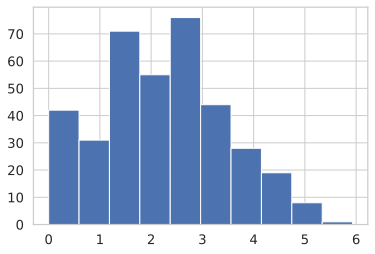

In [35]:
import scipy.stats as stats
lamb=stats.boxcox_normmax(final_str.Gls, brack=(-1.9, 1.9))
print("Lambda:", lamb)
ys=stats.boxcox(final_str.Gls, lmbda=0.23518277737032786)
plt.hist(ys)

In [36]:
final_str['Glsboxcox'] = ys
final_str.head()

/tmp/ipykernel_101198/814169484.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  final_str['Glsboxcox'] = ys


,Name,Market Value (in millions USD),Nation,Pos,Comp,Age,90s,Gls,Sh,SoT,SoT%,Sh/90,SoT/90,G/Sh,G/SoT,Nation_group,Gls2,Glsboxcox
0,Kylian Mbappé,176.0,fr FRA,FW,fr Ligue 1,21.0,26.4,27.0,98.0,47.0,48.0,3.71,1.78,0.21,0.45,top_nation,729.0,4.978517
1,Erling Haaland,143.0,no NOR,FW,de Bundesliga,20.0,26.7,27.0,90.0,47.0,52.2,3.37,1.76,0.28,0.53,rest_of_world,729.0,4.978517
2,Harry Kane,132.0,eng ENG,FW,eng Premier League,27.0,34.2,23.0,134.0,47.0,35.1,3.91,1.37,0.14,0.40,top_nation,529.0,4.636917
3,Jadon Sancho,110.0,eng ENG,FWMF,de Bundesliga,20.0,22.9,8.0,51.0,15.0,29.4,2.23,0.65,0.14,0.47,top_nation,64.0,2.682018
4,Mohamed Salah,110.0,eg EGY,FW,eng Premier League,28.0,34.2,22.0,120.0,46.0,38.3,3.51,1.35,0.13,0.35,rest_of_world,484.0,4.544473


In [58]:
log_gls=['Age','Nation_group','Comp','Sh','Sh/90', 'G/SoT','Gls','Glsboxcox']
X3 = final_str.loc[:,log_gls]
X3_train, X3_test, y3_train, y3_test = train_test_split(pd.get_dummies(X3, drop_first=True), y, test_size=0.2, random_state=26)

lr.fit(X3_train, y3_train)
y3_pred=lr.predict(X3_test)
print(lr.score(X3_train, y3_train),lr.score(X3_test, y3_test))

0.35634043884088973 0.35743435391669465


In [59]:
mae(y3_test, y3_pred)

10.233769325522736

In [41]:
final_str.corr()

,Market Value (in millions USD),Age,90s,Gls,Sh,SoT,SoT%,Sh/90,SoT/90,G/Sh,G/SoT,Gls2,Glsboxcox
Market Value (in millions USD),1.000000,0.019239,0.265197,0.425091,0.405469,0.391495,-0.017240,0.294603,0.215490,0.057646,0.111721,0.408138,0.390199
Age,0.019239,1.000000,0.206497,0.326429,0.294602,0.276526,0.005160,0.172154,0.124456,-0.035131,-0.025772,0.295268,0.300598
90s,0.265197,0.206497,1.000000,0.639018,0.775519,0.728443,-0.084485,0.003930,-0.040901,-0.143313,-0.117309,0.494735,0.688951
Gls,0.425091,0.326429,0.639018,1.000000,0.845028,0.881053,0.190690,0.501684,0.499906,0.270734,0.267958,0.927871,0.931642
Sh,0.405469,0.294602,0.775519,0.845028,1.000000,0.953670,-0.010653,0.570269,0.435583,-0.069730,-0.070107,0.755618,0.818571
SoT,0.391495,0.276526,0.728443,0.881053,0.953670,1.000000,0.224823,0.549667,0.552571,0.051551,-0.040573,0.792268,0.847946
SoT%,-0.017240,0.005160,-0.084485,0.190690,-0.010653,0.224823,1.000000,0.086757,0.606768,0.604402,0.102345,0.146327,0.210768
Sh/90,0.294603,0.172154,0.003930,0.501684,0.570269,0.549667,0.086757,1.000000,0.821659,0.073581,0.018998,0.489430,0.460558
SoT/90,0.215490,0.124456,-0.040901,0.499906,0.435583,0.552571,0.606768,0.821659,1.000000,0.420933,0.099285,0.478599,0.465920
G/Sh,0.057646,-0.035131,-0.143313,0.270734,-0.069730,0.051551,0.604402,0.073581,0.420933,1.000000,0.793318,0.212675,0.290241


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


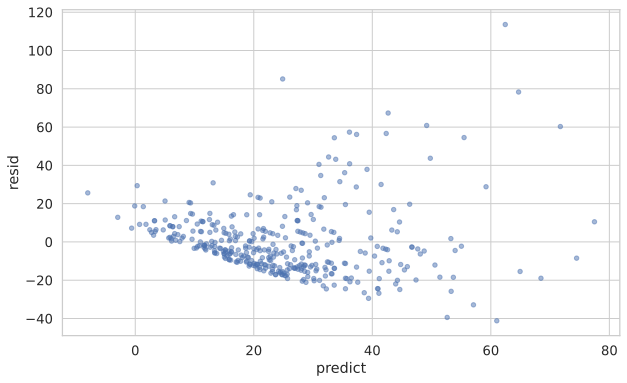

In [60]:
#final_str['predict'] = lr.predict(pd.get_dummies(X3, drop_first=True))
#final_str['resid'] = y-final_str.predict 
plot = final_str.plot(kind='scatter', x='predict', y='resid', alpha=0.5, figsize=(10,6))
plt.savefig('str_residual_plot')

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


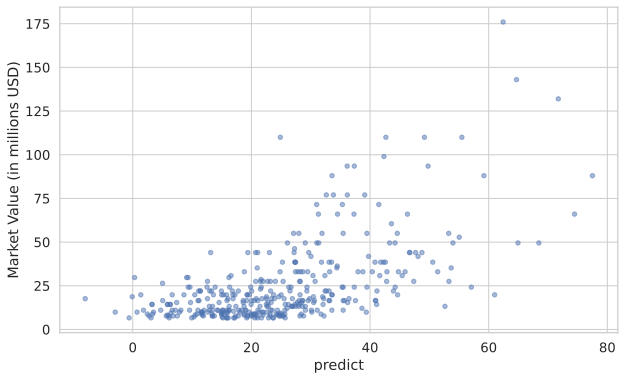

In [61]:
plot = final_str.plot(kind='scatter', x='predict', y='Market Value (in millions USD)', alpha=0.5, figsize=(10,6))
plt.savefig('str_predict_vs_actual')

THIS IS THE START OF THE MIDFIELDER REGRESSION

In [62]:
top_nations = ['fr FRA','es ESP','br BRA','ar ARG','eng ENG','pt POR','be BEL','de GER','it ITA','nl NED']
nation_groupm =[]
for nat in mid_table['Nation']:
    if nat in top_nations:
        nation_groupm.append('top_nation')
    else:
        nation_groupm.append('rest_of_world')
mid_table['Nation_group']=nation_groupm
mid_table.head()

,Name,Market Value (in millions USD),Nation,Pos,Comp,Age,90s,Cmp,Cmp%,TotDist,...,Cmp%.2,Cmp.3,Cmp%.3,Ast,xA,KP,PPA,CrsPA,Prog,Nation_group
0,Kevin De Bruyne,110.0,be BEL,MF,eng Premier League,29.0,22.2,1068.0,76.0,21109.0,...,81.4,176.0,62.9,12.0,10.2,79.0,79.0,9.0,173.0,top_nation
1,Frenkie de Jong,99.0,nl NED,MFDF,es La Liga,23.0,35.0,2598.0,91.8,43830.0,...,95.0,198.0,84.3,4.0,5.5,49.0,34.0,2.0,186.0,top_nation
2,Bruno Fernandes,99.0,pt POR,MF,eng Premier League,25.0,34.4,1702.0,74.6,32546.0,...,79.8,269.0,57.2,12.0,11.0,94.0,96.0,8.0,227.0,top_nation
3,Joshua Kimmich,99.0,de GER,MF,de Bundesliga,25.0,24.4,1790.0,84.0,39402.0,...,90.7,375.0,66.8,10.0,6.6,67.0,58.0,8.0,230.0,top_nation
4,Pedri,88.0,es ESP,MF,es La Liga,17.0,26.8,1514.0,87.6,25928.0,...,90.2,156.0,79.2,3.0,4.7,40.0,39.0,1.0,126.0,top_nation


In [63]:
mid_table.columns

Index(['Name', 'Market Value (in millions USD)', 'Nation', 'Pos', 'Comp',
       'Age', '90s', 'Cmp', 'Cmp%', 'TotDist', 'PrgDist', 'Cmp.1', 'Cmp%.1',
       'Cmp.2', 'Cmp%.2', 'Cmp.3', 'Cmp%.3', 'Ast', 'xA', 'KP', 'PPA', 'CrsPA',
       'Prog', 'Nation_group'],
      dtype='object')

In [65]:
sns.pairplot(mid_table)
plt.savefig('mid_pairplot')

In [66]:
#midfielder
lr = LinearRegression()
mselect_columns = ['Age', 'Comp', 'Nation_group', '90s', 'Cmp', 'Cmp%', 'TotDist', 'PrgDist', 'Cmp.1', 'Cmp%.1','Cmp.2', 'Cmp%.2', 'Cmp.3', 'Cmp%.3', 'Ast', 'xA', 'KP', 'PPA', 'CrsPA','Prog']
Xm = mid_table.loc[:,mselect_columns]
ym = mid_table['Market Value (in millions USD)']
Xm_train, Xm_test, ym_train, ym_test = train_test_split(pd.get_dummies(Xm, drop_first=True), ym, test_size=0.2, random_state=13)
lr.fit(Xm_train, ym_train)
print(lr.score(Xm_train, ym_train),lr.score(Xm_test, ym_test))

0.5208937169340108 0.3965624910686104


In [67]:
split_and_validate(Xm_train, ym_train)


Validation R^2 score was: 0.4034919096949049
Feature coefficient results: 

Age : -2.03
90s : -0.55
Cmp : 0.12
Cmp% : -0.78
TotDist : 0.00
PrgDist : -0.00
Cmp.1 : -0.10
Cmp%.1 : 0.72
Cmp.2 : -0.18
Cmp%.2 : 0.26
Cmp.3 : -0.17
Cmp%.3 : 0.15
Ast : 1.75
xA : 4.71
KP : -0.68
PPA : 0.45
CrsPA : -0.20
Prog : -0.11
Comp_eng Premier League : 9.75
Comp_es La Liga : 3.84
Comp_fr Ligue 1 : -5.51
Comp_it Serie A : 2.39
Nation_group_top_nation : -0.01


In [68]:
std.fit(Xm_train.values)
Xm_tr = std.transform(Xm_train.values)
Xm_te = std.transform(Xm_test.values)

In [69]:
alphavec = 10**np.linspace(-2,2,15000)
lasso_modelm = LassoCV(alphas = alphavec, cv=5)
lasso_modelm.fit(Xm_tr, ym_train)
lasso_modelm.alpha_

/home/aziker/anaconda3/envs/metis/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:526: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.754955194264767, tolerance: 9.063239097098213
  model = cd_fast.enet_coordinate_descent_gram(
/home/aziker/anaconda3/envs/metis/lib/python3.8/site-packages/sklearn/linear_model/_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.531629317491024, tolerance: 11.092886641964284
  model = cd_fast.enet_coordinate_descent(


0.1333956526227024

In [70]:
list(zip(Xm_train.columns, lasso_modelm.coef_))

[('Age', -7.021521172099622),
 ('90s', -5.35412219166955),
 ('Cmp', 3.0755225635069574),
 ('Cmp%', 1.2999607960644528),
 ('TotDist', 5.630708770543126),
 ('PrgDist', -0.7091781164409362),
 ('Cmp.1', 3.85039339814638),
 ('Cmp%.1', 0.2748716514712584),
 ('Cmp.2', 0.0),
 ('Cmp%.2', 0.0),
 ('Cmp.3', 0.0),
 ('Cmp%.3', 0.15056288966328338),
 ('Ast', 5.189248489366842),
 ('xA', 6.903338624372263),
 ('KP', -5.373640155023882),
 ('PPA', 5.564966896674951),
 ('CrsPA', -1.4156803201935855),
 ('Prog', -2.8130099311396557),
 ('Comp_eng Premier League', 4.373969704188979),
 ('Comp_es La Liga', 1.3376534830757385),
 ('Comp_fr Ligue 1', -2.0896370530188677),
 ('Comp_it Serie A', -0.0),
 ('Nation_group_top_nation', 0.4577466256900018)]

In [71]:
ym_pred = lasso_modelm.predict(Xm_te)
lasso_modelm.score(Xm_te, ym_test)

0.38437183602436575

In [72]:
alphavec = 10**np.linspace(-2,2,2000)
lr_model_ridgem = RidgeCV(alphas = alphavec, cv=5)
lr_model_ridgem.fit(Xm_tr, ym_train)
lr_model_ridgem.alpha_

19.392947507175087

In [73]:
list(zip(Xm_train.columns, lr_model_ridgem.coef_))

[('Age', -6.447252006574298),
 ('90s', -4.178867812651644),
 ('Cmp', 2.5880893554971047),
 ('Cmp%', 1.1373682459596626),
 ('TotDist', 2.310229651959778),
 ('PrgDist', -1.4208452473938835),
 ('Cmp.1', 3.1837853575691555),
 ('Cmp%.1', 0.6185002598629596),
 ('Cmp.2', 2.33163643862997),
 ('Cmp%.2', 0.005000199870354022),
 ('Cmp.3', 0.41346531734572245),
 ('Cmp%.3', 0.5464364273007883),
 ('Ast', 4.955383519267166),
 ('xA', 4.777242274990384),
 ('KP', -2.647689394877356),
 ('PPA', 4.865888930678777),
 ('CrsPA', -1.299231664113907),
 ('Prog', -1.6601322882259604),
 ('Comp_eng Premier League', 3.9158873773269023),
 ('Comp_es La Liga', 1.2661695702895115),
 ('Comp_fr Ligue 1', -2.2189409583452684),
 ('Comp_it Serie A', -0.25989910808920985),
 ('Nation_group_top_nation', 0.7822116321220142)]

In [74]:
lr_model_ridgem.score(Xm_te, ym_test)

0.3842620525048809

In [75]:
mid_table.corr()

,Market Value (in millions USD),Age,90s,Cmp,Cmp%,TotDist,PrgDist,Cmp.1,Cmp%.1,Cmp.2,Cmp%.2,Cmp.3,Cmp%.3,Ast,xA,KP,PPA,CrsPA,Prog
Market Value (in millions USD),1.000000,-0.118549,0.272959,0.390325,0.126295,0.373618,0.343658,0.406340,0.166372,0.353150,0.109353,0.328925,0.074335,0.394769,0.395679,0.379022,0.430630,0.147798,0.370969
Age,-0.118549,1.000000,0.166885,0.303244,0.115334,0.307618,0.336773,0.283556,0.153430,0.297157,0.138482,0.289972,0.070563,0.150209,0.154337,0.170060,0.206653,0.145278,0.290796
90s,0.272959,0.166885,1.000000,0.789977,-0.075492,0.769785,0.759776,0.782281,-0.026419,0.743777,-0.046765,0.693618,-0.069958,0.485610,0.530978,0.606207,0.612988,0.389442,0.776081
Cmp,0.390325,0.303244,0.789977,1.000000,0.346471,0.986429,0.947887,0.958048,0.359280,0.980989,0.345385,0.879577,0.228954,0.358753,0.383454,0.482535,0.526641,0.199871,0.880525
Cmp%,0.126295,0.115334,-0.075492,0.346471,1.000000,0.333555,0.213334,0.309344,0.779522,0.393476,0.900367,0.234336,0.762415,-0.294477,-0.343576,-0.290592,-0.234184,-0.432474,0.100992
TotDist,0.373618,0.307618,0.769785,0.986429,0.333555,1.000000,0.963316,0.901837,0.342553,0.984313,0.356175,0.941709,0.241853,0.343663,0.364827,0.469985,0.504404,0.208340,0.876778
PrgDist,0.343658,0.336773,0.759776,0.947887,0.213334,0.963316,1.000000,0.868710,0.263843,0.939642,0.246336,0.916501,0.131388,0.406656,0.444971,0.540422,0.591050,0.310249,0.927179
Cmp.1,0.406340,0.283556,0.782281,0.958048,0.309344,0.901837,0.868710,1.000000,0.352190,0.895532,0.268398,0.736738,0.165364,0.402380,0.437178,0.526673,0.573919,0.207497,0.849939
Cmp%.1,0.166372,0.153430,-0.026419,0.359280,0.779522,0.342553,0.263843,0.352190,1.000000,0.369812,0.654041,0.258069,0.379130,-0.142453,-0.172309,-0.083101,-0.079119,-0.237990,0.157435
Cmp.2,0.353150,0.297157,0.743777,0.980989,0.393476,0.984313,0.939642,0.895532,0.369812,1.000000,0.409695,0.885764,0.276443,0.277028,0.288144,0.379970,0.435274,0.151674,0.838231


In [76]:
X3m = mid_table.loc[:,['Age','Comp', 'Nation_group', 'PPA', 'Cmp.1', '90s', 'xA']]

In [77]:
X3m_train, X3m_test, y3m_train, y3m_test = train_test_split(pd.get_dummies(X3m, drop_first=True), ym, test_size=0.2, random_state=26)

lr.fit(X3m_train, y3m_train)
y3m_pred=lr.predict(X3m_test)
print(lr.score(X3m_train, y3m_train),lr.score(X3m_test, y3m_test))

0.43800504468409973 0.4058348602702496


In [78]:
split_and_validate(X3m_train, y3m_train)


Validation R^2 score was: 0.4674731271089747
Feature coefficient results: 

Age : -1.50
PPA : 0.30
Cmp.1 : 0.04
90s : -0.61
xA : 2.51
Comp_eng Premier League : 7.57
Comp_es La Liga : 1.38
Comp_fr Ligue 1 : -8.70
Comp_it Serie A : -5.60
Nation_group_top_nation : 1.01


In [79]:
mae(y3m_test, y3m_pred)

10.855912182163879

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


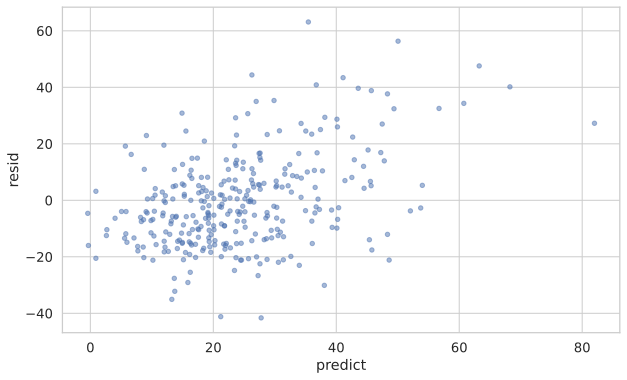

In [80]:
mid_table['predict'] = lr.predict(pd.get_dummies(X3m, drop_first=True))
mid_table['resid'] = ym-final_str.predict 
plot = mid_table.plot(kind='scatter', x='predict', y='resid', alpha=0.5, figsize=(10,6))
plt.savefig('mid_residual_plot')

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


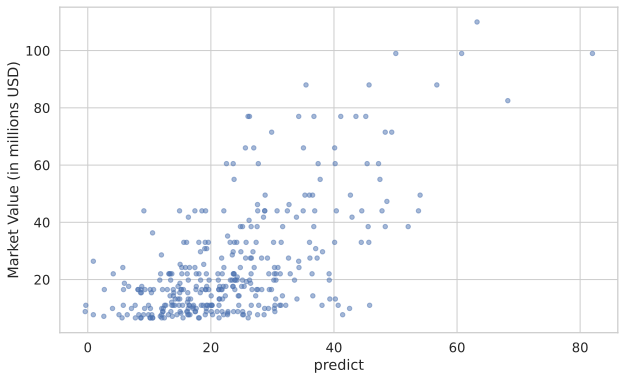

In [81]:
plot = mid_table.plot(kind='scatter', x='predict', y='Market Value (in millions USD)', alpha=0.5, figsize=(10,6))
plt.savefig('mid_predict_vs_actual')